In [5]:
from qiskit import *
import numpy as np
from qiskit.visualization import plot_bloch_multivector
import qiskit.quantum_info as qi
import matplotlib.pyplot as plt

In [21]:
# theta = np.pi/2
# phi = np.pi
theta = np.pi
phi = np.pi/2

psi = np.array([[np.cos(theta/2)], [np.sin(theta/2)*np.exp(1j*phi)]])

In [19]:
psi

array([[1.+0.j],
       [0.+0.j]])

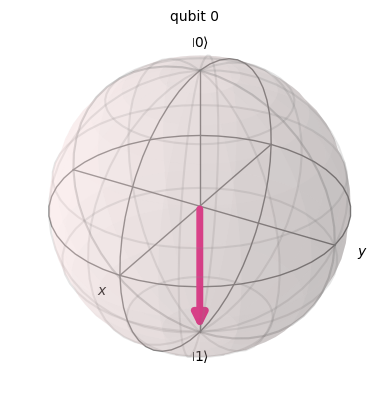

In [22]:
state = qi.Statevector(psi)
plot_bloch_multivector(state)

In [9]:
state

Statevector([ 0.70710678+0.00000000e+00j, -0.70710678+8.65956056e-17j],
            dims=(2,))


In [3]:
from qiskit import QuantumCircuit
from qiskit.visualization import visualize_transition

qc = QuantumCircuit(1)
qc.x(0)
qc.h(0)
qc.draw('mpl')
visualize_transition(qc)

In [39]:
#Deutch-Josza example
n = 3

case = 'constant'
#case = 'constant'

In [40]:
def dj_oracle(case, n):
    oracle_qc = QuantumCircuit(n + 1)
    
    if case == 'balanced':
        for x in range(n):
            oracle_qc.cx(x, n)

    if case == 'constant':
        for x in range(0, n):
            oracle_qc.i(x)

    return oracle_qc

In [41]:
ckt = dj_oracle(case, n)
gate = ckt.to_gate()
gate.name = "oracle"

In [42]:
ckt.draw()

┌───┐
q_0: ┤ I ├
     ├───┤
q_1: ┤ I ├
     ├───┤
q_2: ┤ I ├
     └───┘
q_3: ─────

In [43]:
dj_ckt = QuantumCircuit(n + 1, n)
for i in range(n):
    dj_ckt.h(i)
    
dj_ckt.x(n)
dj_ckt.h(n)

dj_ckt.append(gate, range(n + 1))

for i in range(n):
    dj_ckt.h(i)

for i in range(n):
    dj_ckt.measure(i, i)

from qiskit.tools.visualization import plot_histogram, plot_state_city
simulator = Aer.get_backend('statevector_simulator')

# Run and get counts
result = execute(dj_ckt, shots=1, backend=simulator).result()
svector = result.get_statevector()
svectorf = qi.partial_trace(svector, [n])

dj_ckt.draw()

┌───┐     ┌─────────┐┌───┐┌─┐      
q_0: ┤ H ├─────┤0        ├┤ H ├┤M├──────
     ├───┤     │         │├───┤└╥┘┌─┐   
q_1: ┤ H ├─────┤1        ├┤ H ├─╫─┤M├───
     ├───┤     │  oracle │├───┤ ║ └╥┘┌─┐
q_2: ┤ H ├─────┤2        ├┤ H ├─╫──╫─┤M├
     ├───┤┌───┐│         │└───┘ ║  ║ └╥┘
q_3: ┤ X ├┤ H ├┤3        ├──────╫──╫──╫─
     └───┘└───┘└─────────┘      ║  ║  ║ 
c: 3/═══════════════════════════╩══╩══╩═
                                0  1  2

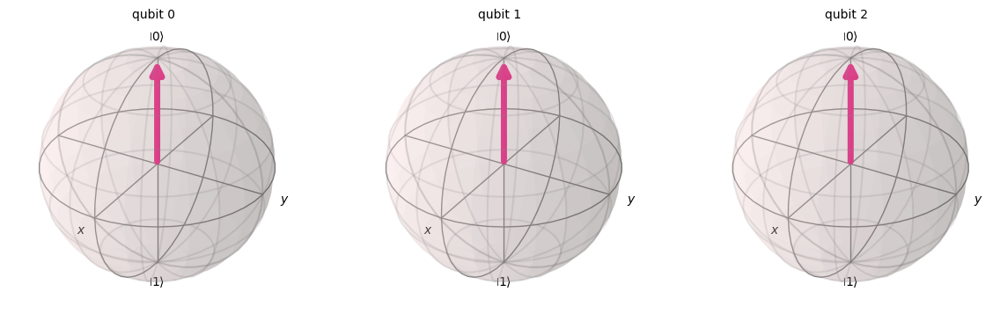

In [44]:
plot_bloch_multivector(svectorf)